<a href="https://colab.research.google.com/github/rootAkash/NerfInJAX/blob/main/InstantNerfDenseSample.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Install the latest JAXlib version.
!pip install --upgrade -q pip jax 
!pip install -U jaxlib==0.4.2+cuda11.cudnn82 -f https://storage.googleapis.com/jax-releases/jax_cuda_releases.html
# Install Flax at head:
!pip install --upgrade -q git+https://github.com/google/flax.git

!pip install open3d
from tqdm.notebook import tqdm
import math
import os
import json
import matplotlib.pyplot as plt
import cv2
import jax
import jax.numpy as jnp                # JAX NumPy
from google.colab.patches import cv2_imshow
import flax
from flax import linen as nn           # The Linen API
from flax.training import train_state,checkpoints  # Useful dataclass to keep train state

import numpy as np      # Ordinary NumPy
from scipy.special import sph_harm               
import optax    
import plotly.graph_objects as go
import plotly.express as px
import open3d as o3d
#download dataset
!wget http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
from jax.config import config
config.update("jax_enable_x64", True)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://storage.googleapis.com/jax-releases/jax_cuda_releases.html
  Preparing metadata (setup.py) ... done
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
--2023-02-09 13:37:02--  http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
Resolving cseweb.ucsd.edu (cseweb.ucsd.edu)... 132.239.8.30
Connecting to cseweb.ucsd.edu (cseweb.ucsd.edu)|132.239.8.30|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cseweb.ucsd.edu//~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz [following]
--2023-02-09 13:37:03--  https://cseweb.ucsd.edu//~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
Connecting to cseweb.ucsd.edu (cseweb.ucsd.edu)|132.239.8.30|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 12727482 (12M)
Saving to: ‘tin

In [ ]:
print(jax.devices())

[StreamExecutorGpuDevice(id=0, process_index=0, slice_index=0)]


In [ ]:

#connect to gdrive to save and reload the model for training
from google.colab import drive
drive.mount('/gdrive')
#import jax.tools.colab_tpu
#jax.tools.colab_tpu.setup_tpu()




Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


(106, 100, 100, 3) (106, 4, 4) ()
focal  138.88887889922103
[[[-9.9990219e-01  4.1922452e-03 -1.3345719e-02 -5.3798322e-02]
  [-1.3988681e-02 -2.9965907e-01  9.5394367e-01  3.8454704e+00]
  [-4.6566129e-10  9.5403719e-01  2.9968831e-01  1.2080823e+00]
  [ 0.0000000e+00  0.0000000e+00  0.0000000e+00  1.0000000e+00]]

 [[-9.3054223e-01  1.1707554e-01 -3.4696460e-01 -1.3986591e+00]
  [-3.6618456e-01 -2.9751042e-01  8.8170075e-01  3.5542498e+00]
  [ 7.4505806e-09  9.4751304e-01  3.1971723e-01  1.2888215e+00]
  [ 0.0000000e+00  0.0000000e+00  0.0000000e+00  1.0000000e+00]]

 [[ 4.4296363e-01  3.1377721e-01 -8.3983749e-01 -3.3854935e+00]
  [-8.9653969e-01  1.5503149e-01 -4.1494811e-01 -1.6727095e+00]
  [ 0.0000000e+00  9.3675458e-01  3.4998694e-01  1.4108427e+00]
  [ 0.0000000e+00  0.0000000e+00  0.0000000e+00  1.0000000e+00]]

 [[ 7.9563183e-01  5.2092606e-01 -3.0920234e-01 -1.2464346e+00]
  [-6.0578054e-01  6.8418401e-01 -4.0610620e-01 -1.6370665e+00]
  [-1.4901161e-08  5.1041979e-01  8.59

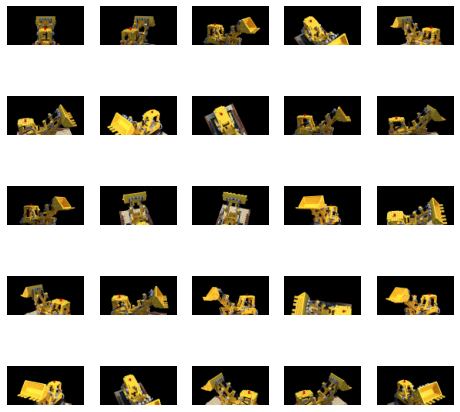

In [ ]:
data = np.load('tiny_nerf_data.npz')
images = data["images"]
poses = data['poses']
focal = data['focal']
print(images.shape,poses.shape,focal.shape)
print("focal ",focal)
images = images[:25]
fig, ax = plt.subplots(5, 5, figsize = (8,8))

for i in range(5):
    mini = images[i*5:(i+1)*5]
    print(poses[i*5:(i+1)*5])
    for j in range(mini.shape[0]):
        print(mini[j][:50,:,:].shape,mini[j][50,50,:])
        ax[i][j].imshow(mini[j][:50,:,:])
        ax[i][j].axis("off")
plt.show()

In [ ]:
def get_scale_and_shift_correction(data,tf,tn=0):
  """
  data={
      "images":images,
      "origins":origins,
      "unitDir":univecs,
      "gt":ground_truth,
      "fx":focalsX,
      "fy":focalsY,
      "indexes": imageIndexs,
      "poses":poses
  }
  """
  focalx = data['fx']
  focaly = data['fy']
  images=data['images']
  poses = data['poses']

  extermities =[]
  
  img_height = images[0].shape[0]-1
  img_width = images[0].shape[1]-1
  image_lefttop=(0,0)
  image_righttop=(0,img_width)
  image_leftbot=(img_height,0)
  image_rightbot=(img_height,img_width)
  image_center=(img_height//2,img_width//2)
  key_points = {image_lefttop,image_righttop,image_leftbot,image_rightbot,image_center}
  for i in tqdm(range(images.shape[0])):
    image = images[i]
    pose = poses[i]
    campos,camDir,_ = rayVariables(image_center[1],image_center[0],focalx,focaly,pose,image.shape[1],image.shape[0])
    #append the camera origin 
    extermities.append(campos + camDir*tn)
    for y in range(image.shape[0]):
      for x in range(image.shape[1]):
        if (y,x) in key_points:
          campos,camDir,_ = rayVariables(x,y,focalx,focaly,pose,image.shape[1],image.shape[0])
          extermities.append(campos + camDir*tf)
  
  extermities = np.asarray(extermities)
  min = jnp.min(extermities,axis=0)
  shift_correction = -min
  corrected_extermities = extermities+shift_correction
  scale = jnp.max(corrected_extermities)

  return shift_correction,scale
def rayVariables(x,y,focalx,focaly,camera_toworld_matrix,imgW,imgH):
    k = jnp.array([[focalx,0,imgW*0.5],[0,focaly,imgH*0.5],[0,0,1]])
    kinv = jnp.linalg.inv(k)
    imgPos = jnp.array([x,y,1]).T
    rayDirections_wrt_Cam = kinv@imgPos*np.array([1,-1,-1])# to fix the direction of axes
    unitVecCam = rayDirections_wrt_Cam/(rayDirections_wrt_Cam**2).sum()**0.5
    unitVec_wrt_world = jnp.matmul(camera_toworld_matrix[:3,:3],unitVecCam.T)#using Rmatrix for getting direction of projected rays wrt world
    camPos_wrt_world = camera_toworld_matrix[:3,-1] #using Tmatrix for getting origin (camera pos) of projected rays wrt world
    
    return camPos_wrt_world,unitVec_wrt_world,kinv
vectorizedRayVariables = jax.jit(jax.vmap(rayVariables,in_axes =(0,0,None,None,None,None,None))) # vectorised the function
def GetVolumeRenderData(focalx,focaly,camera_toworld_matrix,img_gt,image_index):
  imgW=img_gt.shape[1]
  imgH=img_gt.shape[0]
  xs,ys = jnp.meshgrid(jnp.arange(imgW), jnp.arange(imgH)) 
  xs=xs.T.ravel()
  ys = ys.T.ravel()
  #focalsx = jnp.repeat(focalx,imgW*imgH)
  #focalsy = jnp.repeat(focaly,imgW*imgH)
  #camera_toworld_matrixs = jnp.tile(jnp.array([camera_toworld_matrix]),(imgW*imgH,1,1))
  #imgWs = jnp.repeat(imgW,imgW*imgH)
  #imgHs = jnp.repeat(imgH,imgW*imgH)
  #call the vectorised version of rayCast to get origin and directions for each pixel ray 
  camPoss_wrt_world,unitVecs_wrt_world,kinvs= vectorizedRayVariables(xs,ys,focalx,focaly,camera_toworld_matrix,imgW,imgH)
  gt_colors = img_gt[ys,xs,:]
  indexes = jnp.repeat(image_index,imgW*imgH)
  #print(encodedRayPoints.shape,encodedRayDirections.shape,rayDeltas.shape,gt_colors.shape)
  return camPoss_wrt_world,unitVecs_wrt_world,gt_colors,indexes
def getNerfSyntheticData(downsample = 1 ):
  data = np.load('tiny_nerf_data.npz')
  imagesData = data["images"]
  posesData = data['poses']
  focal = data['focal']
  focalsX = focal/downsample
  focalsY = focal/downsample
  images =[]
  poses=[]
  origins =[]
  univecs=[]
  imageIndexs=[]#later for trainable camera params 
  ground_truth=[]
  #intrincis =[]
  #generate training data
  print("processing " , imagesData.shape[0] , " images")
  for i in range(imagesData.shape[0]):
    image = imagesData[i]
    pose  = posesData[i]
    width = int(image.shape[1]/ downsample)
    height = int(image.shape[0]/ downsample)
    dim = (width, height)
    # resize image
    resized = cv2.resize(image, dim, interpolation = cv2.INTER_AREA)
    
    image = jnp.asarray(resized)
    images.append(image)
    poses.append(pose)
    camPoss_wrt_world,unitVecs_wrt_world,gt_colors,indexes = GetVolumeRenderData(focalsX,focalsY,pose,image,i)
    origins.append(camPoss_wrt_world)
    univecs.append(unitVecs_wrt_world)
    ground_truth.append(gt_colors)
    imageIndexs.append(jnp.expand_dims(indexes,1))


  images= jnp.asarray(images)
  poses = jnp.asarray(poses)
  origins = jnp.vstack(origins)
  univecs=jnp.vstack(univecs)
  imageIndexs=jnp.vstack(imageIndexs)
  ground_truth=jnp.vstack(ground_truth)

  test_index = 1#imagesData.shape[0]-1#UNSEEN
  test_image = imagesData[test_index]
  test_pose  = posesData[test_index]
  test_width = int(test_image.shape[1]/ downsample)
  test_height = int(test_image.shape[0]/ downsample)
  test_dim = (test_width, test_height)
  resized_test_image = cv2.resize(test_image, test_dim, interpolation = cv2.INTER_AREA)
  test_image = jnp.asarray(resized_test_image)
  test_camPoss_wrt_world,test_unitVecs_wrt_world,test_gt_colors,test_indexes = GetVolumeRenderData(focalsX,focalsY,test_pose,test_image,len(imagesData)-1)
  traindata={
      "images":images,
      "origins":origins,
      "unitDir":univecs,
      "gt":ground_truth,
      "fx":focalsX,
      "fy":focalsY,
      "indexes": imageIndexs,
      "poses":poses
  }
  shift_correction,scale=get_scale_and_shift_correction(traindata,tf=10,tn=0)
  traindata["origins"] = (traindata["origins"] + shift_correction)/scale
  traindata["shiftfix"] = shift_correction
  traindata["scale"] = scale
  
  testdata={
        "images":test_image,
        "origins":(test_camPoss_wrt_world +  shift_correction)/scale,
        "unitDir":test_unitVecs_wrt_world,
        "gt":test_gt_colors
  }
  print("train data: ")
  print("resolution:" ,  traindata["images"][0].shape)
  print("number of train images: ", traindata["images"].shape[0])
  print("origins : ",traindata["origins"].shape)
  print("unitDir : ",traindata["unitDir"].shape)
  print("gt : ",traindata["gt"].shape)
  print("indexes : ",traindata["indexes"].shape)
  return traindata,testdata
"""
def get_custom_dataset(downsample = 5):
  f = open("/gdrive/MyDrive/Nerfies/custom_data/transforms.json")
  data = json.load(f)
  f.close()
  focalsX = data['fl_x']/downsample
  focalsY = data['fl_y']/downsample
  imagesData = data['frames']
  images = []
  poses =[]
  origins =[]
  univecs=[]
  imageIndexs=[]#later for trainable camera params 
  ground_truth=[]
  #intrincis =[]

  base_path_images = "/gdrive/MyDrive/Nerfies/custom_data/"
  #generate training data
  print("processing " , len(imagesData) , " images")
  for i,d in enumerate(imagesData[list(range(0,len(imagesData),5 ))]):
    full_img_path = base_path_images+d["file_path"]
    image = cv2.cvtColor(cv2.imread(full_img_path), cv2.COLOR_BGR2RGB)
    
    width = int(image.shape[1]/ downsample)
    height = int(image.shape[0]/ downsample)
    dim = (width, height)
    # resize image
    resized = cv2.resize(image, dim, interpolation = cv2.INTER_AREA)
    
    image = jnp.asarray(resized)/255.0
    images.append(image)
    pose = jnp.asarray(d["transform_matrix"])
    poses.append(pose)
    camPoss_wrt_world,unitVecs_wrt_world,gt_colors,indexes = GetVolumeRenderData(focalsX,focalsY,pose,image,i)
    origins.append(camPoss_wrt_world)
    univecs.append(unitVecs_wrt_world)
    ground_truth.append(gt_colors)
    imageIndexs.append(jnp.expand_dims(indexes,1))


  images= jnp.asarray(images)
  poses = jnp.asarray(poses)
  origins = jnp.vstack(origins)
  univecs=jnp.vstack(univecs)
  imageIndexs=jnp.vstack(imageIndexs)
  ground_truth=jnp.vstack(ground_truth)

  test_index = 0#len(imagesData)-1
  test_data = imagesData[test_index]
  full_test_img_path = base_path_images+test_data["file_path"]
  test_image = cv2.cvtColor(cv2.imread(full_test_img_path), cv2.COLOR_BGR2RGB)
  resized_test_image = cv2.resize(test_image, dim, interpolation = cv2.INTER_AREA)
  test_image = jnp.asarray(resized_test_image)/255.0
  test_pose = jnp.asarray(test_data["transform_matrix"])
  test_camPoss_wrt_world,test_unitVecs_wrt_world,test_gt_colors,test_indexes = GetVolumeRenderData(focalsX,focalsY,test_pose,test_image,len(imagesData)-1)
  traindata={
      "images":images,
      "origins":origins,
      "unitDir":univecs,
      "gt":ground_truth,
      "fx":focalsX,
      "fy":focalsY,
      "indexes": imageIndexs,
      "poses":poses
  }
  shift_correction,scale=get_scale_and_shift_correction(traindata,tf=10,tn=0)
  traindata["origins"] = (traindata["origins"] + shift_correction)/scale
  testdata={
        "images":test_image,
        "origins":(test_camPoss_wrt_world +  shift_correction)/scale,
        "unitDir":test_unitVecs_wrt_world,
        "gt":test_gt_colors
  }
  print("train data: ")
  print("resolution:" ,  traindata["images"][0].shape)
  print("number of train images: ", traindata["images"].shape[0])
  print("origins : ",traindata["origins"].shape)
  print("unitDir : ",traindata["unitDir"].shape)
  print("gt : ",traindata["gt"].shape)
  print("indexes : ",traindata["indexes"].shape)
  return traindata,testdata
"""
def uniformSample(rng,minVal,maxVal):
  return jax.random.uniform(rng,minval=minVal, maxval=maxVal)
vectorizedUniformSample = jax.jit(jax.vmap(uniformSample,in_axes =(0,0,0)))
def sample_from_piecewise(span,num_points,ts,probs,prngKey):
  num_points = num_points +1
  key1,key2 = jax.random.split(prngKey)
  sampled_points = jax.random.choice(key1,ts.ravel(),(num_points,),p=probs.ravel())
  newSamples =  vectorizedUniformSample(jax.random.split(key2,num_points),sampled_points,(sampled_points +span))
  newSamples = jnp.sort(newSamples)
  return newSamples
def VolumeRenderPoint(params,occupancy_grid,origin,direction,Prng,use_occupanncy=True):
  def true_fn(sigma_val,current_transmittance):
    return sigma_val
  def false_fn(sigma_val,current_transmittance):
    return 0*sigma_val

  #set tf and tn using the values from the depth array
  threshold_opacity = 0.01
  occupancy_res = occupancy_grid.shape[0]
  Tf = 1
  Tn = 0
  numPoints=1024
  ray_marching_step = 3**0.5/1024
  sigma_thres= threshold_opacity/ray_marching_step
  transmittance_thres = 0.0001
  selectPoints=64


  #function to generate selectPoints amount of points without using occupancy grid
  def sample_occupancy_false(Prng):
    width = (Tf-Tn)/selectPoints
    points = []
    directions =[]
    ts =[]
    for  i in range(1,selectPoints+2):
        Prng,rngkey = jax.random.split(Prng)
        ti =  jax.random.uniform(rngkey,minval=Tn+(i-1)*width, maxval=Tn+i*width) #uniform sample ( tn + (i-1)*w , tn+ i*w )
        #ti = Tn + i*width #no randomness
        #print(ti)
        del rngkey
        ts.append(ti)
        point = origin + direction*ti # p= O + Dt
        points.append(point) # p= O + Dt
        directions.append(direction)
    return jnp.asarray(ts),jnp.asarray(points),jnp.asarray(directions)
  def sample_occupancy_true(Prng):
    #get points that are important by accelarted ray marching and early termination
    current_transmittance=0
    cumulative_sig_del_sum=0

    old_ts =[]
    sigmas=[]
    for  i in range(1,numPoints+2):
        Prng,rngkey = jax.random.split(Prng)
        ti = Tn + i*ray_marching_step #no randomness
        #print(ti)
        del rngkey
        
        point = origin + direction*ti # p= O + Dt
        indexs = jnp.floor(point*occupancy_res)
        sigma_val = occupancy_grid[indexs[0].astype(int),indexs[1].astype(int),indexs[2].astype(int)]
        cumulative_sig_del_sum = cumulative_sig_del_sum + sigma_val*ray_marching_step
        current_transmittance=jnp.exp(-cumulative_sig_del_sum)#T[i] = e**(-(sig[1]*del[1] + sig[2]*del[2] + sig[3]*del[3] ----- sig[i-1]*del[i-1])) # here delta is fixed = ray_marching_step 
        sigmas.append(jax.lax.cond((sigma_val > sigma_thres) & (current_transmittance > transmittance_thres), true_fn, false_fn, sigma_val,current_transmittance))
        old_ts.append(ti)
    # sample $selectPoints amount of ts based on their sigma distribution
    probs = jnp.asarray(sigmas)
    probs = probs/jnp.sum(probs)
    old_ts=jnp.asarray(old_ts)

    newts = sample_from_piecewise(ray_marching_step,selectPoints,old_ts,probs,Prng)
    newpoints =jnp.expand_dims(origin,0) + jnp.expand_dims(newts,-1)*jnp.repeat(jnp.expand_dims(direction,0),newts.shape[0],0) # p= O + Dt
    newdirs=jnp.repeat(jnp.expand_dims(direction,0),newts.shape[0],0)
    return newts,newpoints,newdirs
  newts,newpoints,newdirs = jax.lax.cond(use_occupanncy, sample_occupancy_true, sample_occupancy_false, Prng)
  #if use_occupanncy:
  #  newts,newpoints,newdirs = sample_occupancy_true()
  #else : 
  #  newts,newpoints,newdirs = sample_occupancy_false()
  #print(newpoints.shape,newdirs.shape)
  rayDeltas = jnp.expand_dims(jnp.diff(newts),1)
  directions = jnp.array(newdirs)[:-1]
  points = jnp.array(newpoints)[:-1]
  ts = jnp.expand_dims(jnp.array(newts)[:-1],1)
  #print("rayDeltas",rayDeltas.shape,"directions",directions.shape,"points",points.shape,"ts",ts.shape)
  sigmas,colors = Nerf().apply({'params': params},points,directions)
  sigmas=jnp.expand_dims(sigmas,1)#numPoints,1
  #print("sigma",sigmas.shape,"color",colors.shape)
  
  #now we use volumetric rendering computation to get the pixel values
  alphas = 1- jnp.exp(-rayDeltas*sigmas)
  #cumsum = jnp.roll(jnp.cumsum(rayDeltas*sigmas,-1),1,-1)
  #cumsum=cumsum.at[...,0].set(1)
  cumsum = jnp.roll(jnp.cumsum(rayDeltas*sigmas,-1),1,0)
  cumsum=cumsum.at[0].set(1)
  transparancies=jnp.exp(-cumsum)
  weights = transparancies*alphas
  #print(transparancies.shape,alphas.shape,weights.shape)
  prod = weights*colors
  depth = jnp.sum(weights*ts,axis=-2)
  final_color=jnp.sum(prod,axis=-2)

  return final_color,depth
vectorizedVolumeRenderPoint = jax.jit(jax.vmap(VolumeRenderPoint,in_axes =(None,None,0,0,0,None))) # vectorised the function
def VolumeRenderingBatch(params,occupancy_grid,batch_origins,batch_directions,PRNGKey,use_occupancy):
  BatchPrngkeys = jax.random.split(PRNGKey,batch_origins.shape[0])

  colors_output,depth = vectorizedVolumeRenderPoint(params,occupancy_grid,batch_origins,batch_directions,BatchPrngkeys,use_occupancy)

  return colors_output,depth
def VolumeRenderSingleImage(params,occupancy_grid,gt_cols,gt_image,origins,directions,PRNGKey,use_occupancy):
  color_op,depth_op= VolumeRenderingBatch(params,occupancy_grid,origins,directions,PRNGKey,use_occupancy)
  color_op = color_op.reshape((gt_image.shape[1],gt_image.shape[0],gt_image.shape[2])).transpose(1,0,2)
  depth_op = depth_op.reshape((gt_image.shape[1],gt_image.shape[0],1)).transpose(1,0,2)
  depth_op = jnp.stack([depth_op,depth_op, depth_op], axis = 2).reshape(gt_image.shape)
  return color_op,depth_op
def select_random_point(xindex,yindex,zindex,prng,resolution):
  pointinsidecube = jnp.array([jax.random.uniform(prng),jax.random.uniform(prng),jax.random.uniform(prng)])
  point = (jnp.array([xindex,yindex,zindex])+pointinsidecube)/resolution
  return point

vectorised_select_random_points = jax.jit(jax.vmap(select_random_point,in_axes =(0,0,0,0,None))) # vectorised the function
def update_occupancy_grid(occupancy_grid,params,prng):
  res=occupancy_grid.shape[0]
  xindices,yindices,zindices = jnp.indices(occupancy_grid.shape)
  xindices,yindices,zindices = xindices.ravel(),yindices.ravel(),zindices.ravel()
  Prngkeys = jax.random.split(prng,xindices.shape[0])
  points= vectorised_select_random_points(xindices,yindices,zindices,Prngkeys,res)
  newvalues,_ = Nerf().apply({'params': params},points,jnp.zeros_like(points))
  occupancy_grid=occupancy_grid.at[xindices,yindices,zindices].set(jnp.maximum(occupancy_grid[xindices,yindices,zindices]*0.95 , newvalues))
  return occupancy_grid
@jax.jit
def train_step(state,occupancy_grid,batch_origins,batch_directions,ground_truths,prngKey,use_occupancy):
  """Train for a single step for a batch of images"""
  def loss_fn(params):
    #BatchParams = jnp.repeat(params,batch_imgs.shape[0])
    output_vals,_= VolumeRenderingBatch(params,occupancy_grid,batch_origins,batch_directions,prngKey,use_occupancy)
    loss = mse_loss(output_vals,ground_truths)
    return loss,(output_vals)
  grad_fn = jax.value_and_grad(loss_fn, has_aux=True)
  (loss, (output_vals)), grads = grad_fn(state.params)
  #print("all gradients",grads)
  #print("hash_map gradients",grads["hash_map"])
  #densityPred
  state = state.apply_gradients(grads=grads)
  return state,loss,output_vals
def train_epoch(state,occupancy_grid, train_data,test_data, batch_size, epoch, rng):
  """Train for a single epoch."""
  if epoch < 20:
    use_occupancy = False
  else:
    use_occupancy = True
  train_ds_size = train_data["origins"].shape[0]
  steps_per_epoch = train_ds_size // batch_size
  perms = jax.random.permutation(rng, train_ds_size)
  perms = perms[:steps_per_epoch * batch_size]  # skip incomplete batch
  perms = perms.reshape((steps_per_epoch, batch_size))
  batch_losses = []
  for perm in tqdm(perms):
    rng,newRng = jax.random.split(rng)
    batch_origins = train_data["origins"][perm, ...]
    batch_directions = train_data["unitDir"][perm, ...]
    ground_truths = train_data["gt"][perm, ...]
    state, loss ,ops= train_step(state,occupancy_grid,batch_origins,batch_directions,ground_truths,newRng,use_occupancy)#state, batch_imgs,batch_focal,batch_cam_to_world,prngKey
    batch_losses.append(loss)
  
  # compute mean of metrics across each batch in epoch.
  batch_losses_np = jax.device_get(batch_losses)
  #update occupancy
  #if epoch%16==0:
  
  occupancy_grid = update_occupancy_grid(occupancy_grid,state.params,rng)
  print("train epoch: ",epoch ," loss: ",np.mean(batch_losses))
  outPutImg ,depth = VolumeRenderSingleImage(state.params,occupancy_grid,test_data["gt"],test_data["images"],test_data["origins"],test_data["unitDir"],newRng,use_occupancy)#params,gt_cols,gt_image,origins,directions,PRNGKey

  #print("max depth : ", jnp.max(depth.ravel()), " min depth : ",jnp.min(depth.ravel()) )
  #print(depth)
  #depth = jnp.reshape(jnp.stack([depth, depth, depth], axis = 2),(depth.shape[0],depth.shape[1],3))/jnp.max(depth.ravel())
  #print(outPutImg.shape,depth.shape,batch_images[0].shape)
  #plt.imshow(np.hstack([np.asarray(outPutImg),np.asarray(1-depth),np.asarray(batch_images[0])]))
  plt.imshow(np.hstack([np.asarray(outPutImg),np.asarray(depth),np.asarray(test_data["images"])]))
  plt.axis("off")
  plt.show()
  #plot occupancy
  #ax = plt.figure().add_subplot(projection='3d')
  #ax.voxels(occupancy_grid>0.2, edgecolor='k')
  #plt.show()
  return occupancy_grid,state

In [ ]:

def getbeta(n_max,n_min,levels):
  return jnp.exp((jnp.log(n_max)-jnp.log(n_min))/(levels-1))

def getNwrtLayer(n_min,b,levels):
  Nls =[]
  for l in range(levels):
    Nls.append(jnp.floor(n_min*(b**l)))
  return jnp.asarray(Nls) 

def spatialHashVec(position,table_size):
  h = 0
  coeffs = [1,2654435761,805459861]
  for i in range(position.shape[0]):
    h = h^(position[i].astype(int)*coeffs[i])
  return h%table_size
vectorized_spatialHashVec =jax.jit(jax.vmap(spatialHashVec,in_axes =(0,None)))

def TriInterpol(x_val , y_val ,z_val , valA,valB,valC,valD,valE,valF,valG,valH):
  corners = jnp.array([[0,0,0],[1,0,0],[0,1,0],[1,1,0],[0,0,1],[1,0,1],[0,1,1],[1,1,1]])
  corner_xs = corners[:,0]
  corner_ys = corners[:,1]
  corner_zs = corners[:,2]
  polyfitmatrix = jnp.array([jnp.ones_like(corner_xs),corner_xs,corner_ys,corner_zs,corner_xs*corner_ys,corner_xs*corner_zs,corner_ys*corner_zs,corner_xs*corner_ys*corner_zs]).T
  values = jnp.array([valA,valB,valC,valD,valE,valF,valG,valH])
  coeffs = jnp.linalg.inv(polyfitmatrix)@values
  query  =  jnp.array([1,x_val,y_val,z_val,x_val*y_val,x_val*z_val,y_val*z_val,x_val*y_val*z_val])
  final_value = query@coeffs
  return final_value
vectorized_triInterpol =jax.jit(jax.vmap(TriInterpol,in_axes =(0,0,0,0,0,0,0,0,0,0,0)))
def unit_vector_to_spherical_harmonics_complex(dir):
    x = dir[0]
    y = dir[1]
    z = dir[2]
    # Convert the 3D vector to spherical coordinates
    r = jnp.sqrt(x**2 + y**2 + z**2)
    
    # Calculate the spherical harmonic coefficients up to degree 1
    Y00 = 1 / jnp.sqrt(4 * jnp.pi)
    Y1m1 = jnp.sqrt(3 / (8 * jnp.pi)) *((jax.lax.complex(x,-y))/r)
    Y10 = jnp.sqrt(3 / (4 * jnp.pi)) * (z/r)
    Y11 = -jnp.sqrt(3 / (8 * jnp.pi)) * ((jax.lax.complex(x,y))/r)
    
    # Calculate the spherical harmonic coefficients up to degree 2
    Y2m2 = jnp.sqrt(15 / (16*2 * jnp.pi)) * ((jax.lax.complex(x,-y)**2)/r**2)
    
    Y2m1 = jnp.sqrt(15 / (4*2 * jnp.pi)) * ((jax.lax.complex(x,-y))*z/r**2)
    
    Y20 = jnp.sqrt(5 / (16 * jnp.pi)) * ((3*z**2-r**2)/r**2)
    
    Y21 = -jnp.sqrt(15 / (4*2 * jnp.pi)) * ((jax.lax.complex(x,y))*z/r**2)
    
    Y22 = jnp.sqrt(15 / (16*2 * jnp.pi)) * ((jax.lax.complex(x,y)**2)/r**2)
    
    # Calculate the spherical harmonic coefficients up to degree 3
    Y3m3 = jnp.sqrt(35 / (8**2  * jnp.pi)) * ((jax.lax.complex(x,-y)**3)/r**3)
    Y3m2 = jnp.sqrt(105 / (16*2 * jnp.pi)) * ((jax.lax.complex(x,-y)**2*z)/r**3)
    Y3m1 = jnp.sqrt(21 / (8**2 * jnp.pi)) *((jax.lax.complex(x,-y)*(5*z**2 -r**2))/r**3)
    Y30 = jnp.sqrt(7 / (16 * jnp.pi)) * ((5*z**3 - 3*z*r**2)/r**3)
    Y31 = -jnp.sqrt(21 / (8**2* jnp.pi)) *((jax.lax.complex(x,y)*(5*z**2 - r**2))/r**3)
    Y32 = jnp.sqrt(105 / (16 *2 * jnp.pi )) *((jax.lax.complex(x,y)**2*z)/r**3)
    Y33 = -jnp.sqrt(35 / (8**2 * jnp.pi )) *((jax.lax.complex(x,y)**3)/r**3)
    return jnp.array([Y00.real,Y1m1.real,Y10.real,Y11.real,Y2m2.real,Y2m1.real,Y20.real,Y21.real,Y22.real,Y3m3.real,Y3m2.real,Y3m1.real,Y30.real,Y31.real,Y32.real,Y33.real])
vectorized_unit_vector_to_spherical_harmonics = jax.jit(jax.vmap(unit_vector_to_spherical_harmonics_complex,in_axes =(0))) 
class Nerf(nn.Module):
  """ Model """
  def setup(self):
    #self.layer = nn.Dense(features=64)
    self.levels=16
    self.table_size = 2**19
    self.embedding_feature_dim=2
    self.n_min =16
    self.n_max = 512*8
    self.b = getbeta(self.n_max,self.n_min,self.levels)
    self.densityFeatures = nn.Dense(features=16)
    self.sigmaPred = nn.Dense(features=1)
    self.colFeatures1= nn.Dense(features=64)
    self.colFeatures2= nn.Dense(features=64)
    self.colPred = nn.Dense(features=3)
    self.hashMap = self.param('hash_map',nn.initializers.lecun_normal(),(self.levels,self.table_size,self.embedding_feature_dim))
    self.scaling = getNwrtLayer(self.n_min,self.b,self.levels)
  
  def __call__(self, xyz,dir):
    embeddings = []
    for i in range(len(self.scaling)):
      xs = xyz[:,0]*self.scaling[i]
      ys = xyz[:,1]*self.scaling[i]
      zs = xyz[:,2]*self.scaling[i]
      x_vals = xs - jnp.floor(xs)
      y_vals = ys - jnp.floor(ys)
      z_vals = zs - jnp.floor(zs)
      #[[0,0,0],[1,0,0],[0,1,0],[1,1,0],[0,0,1],[1,0,1],[0,1,1],[1,1,1]]
      cornersA = vectorized_spatialHashVec(jnp.array([jnp.floor(xs),jnp.floor(ys),jnp.floor(zs)]).T,self.table_size)#maps to [0,0,0]
      cornersB = vectorized_spatialHashVec(jnp.array([ jnp.ceil(xs),jnp.floor(ys),jnp.floor(zs)]).T,self.table_size)#maps to [1,0,0]
      cornersC = vectorized_spatialHashVec(jnp.array([jnp.floor(xs), jnp.ceil(ys),jnp.floor(zs)]).T,self.table_size)#maps to [0,1,0]
      cornersD = vectorized_spatialHashVec(jnp.array([ jnp.ceil(xs), jnp.ceil(ys),jnp.floor(zs)]).T,self.table_size)#maps to [1,1,0]
      cornersE = vectorized_spatialHashVec(jnp.array([jnp.floor(xs),jnp.floor(ys), jnp.ceil(zs)]).T,self.table_size)#maps to [0,0,1]
      cornersF = vectorized_spatialHashVec(jnp.array([ jnp.ceil(xs),jnp.floor(ys), jnp.ceil(zs)]).T,self.table_size)#maps to [1,0,1]
      cornersG = vectorized_spatialHashVec(jnp.array([jnp.floor(xs), jnp.ceil(ys), jnp.ceil(zs)]).T,self.table_size)#maps to [0,1,1]
      cornersH = vectorized_spatialHashVec(jnp.array([ jnp.ceil(xs), jnp.ceil(ys), jnp.ceil(zs)]).T,self.table_size)#maps to [1,1,1]

      valA = self.hashMap[i,cornersA,:]
      valB = self.hashMap[i,cornersB,:]
      valC = self.hashMap[i,cornersC,:]
      valD = self.hashMap[i,cornersD,:]
      valE = self.hashMap[i,cornersE,:]
      valF = self.hashMap[i,cornersF,:]
      valG = self.hashMap[i,cornersG,:]
      valH = self.hashMap[i,cornersH,:]
      #print(valA.shape)#10000,2
      x = vectorized_triInterpol(x_vals,y_vals,z_vals,valA,valB,valC,valD,valE,valF,valG,valH) #(x_val,y_val,z_val,valA,valB,valC,valD,valE,valF,valG,valH) 
      #interpolated output shape (10000, 2)
      embeddings.append(x)
    embeddings = jnp.concatenate(embeddings,axis  =1) # embdding shape (10000, 32)
    densityFeat = self.densityFeatures(embeddings)
    densityFeat = nn.relu(densityFeat)
    sig = densityFeat[:,0]

    
    colEmbeddings = jnp.concatenate([densityFeat[:,1:],vectorized_unit_vector_to_spherical_harmonics(dir)],axis  =1)
    colFeat = self.colFeatures1(colEmbeddings)
    colFeat = nn.relu(colFeat)
    colFeat = self.colFeatures2(colFeat)
    colFeat = nn.relu(colFeat)
    col = self.colPred(colFeat)
    col = nn.sigmoid(col)
    return jnp.exp(sig),col
def mse_loss( pred, labels):
  return jnp.mean((pred-labels)**2)
def create_learning_rate_fn(warmup_epochs,num_epochs, base_learning_rate, steps_per_epoch):
  """Creates learning rate schedule."""
  warmup_fn = optax.linear_schedule(
      init_value=3e-4, end_value=base_learning_rate,
      transition_steps=warmup_epochs * steps_per_epoch)
  cosine_epochs = max(num_epochs - warmup_epochs, 1)
  cosine_fn = optax.cosine_decay_schedule(
      init_value=base_learning_rate,
      decay_steps=cosine_epochs * steps_per_epoch)
  schedule_fn = optax.join_schedules(
      schedules=[warmup_fn, cosine_fn],
      boundaries=[warmup_epochs * steps_per_epoch])
  return schedule_fn
def create_train_state(rng, warmup_epochs,num_epochs, steps_per_epoch,base_learning_rate, momentum,use_schedule = False):
  """Creates initial `TrainState`."""
  nerf = Nerf()
  params = nerf.init(rng, jnp.ones([1,3]),jnp.ones([1,3]))['params']
  if use_schedule:
    tx = optax.adam(create_learning_rate_fn(warmup_epochs,num_epochs, base_learning_rate, steps_per_epoch), momentum)
  else:
    tx = optax.adam(base_learning_rate, momentum)
  return train_state.TrainState.create(
      apply_fn=nerf.apply, params=params, tx=tx)
def restore_checkpoint(state, workdir,modelPrefix): 
  return checkpoints.restore_checkpoint(workdir, state,prefix=modelPrefix) 
  
  
def save_checkpoint(state,occupancy_grid,workdir,modelPrefix): 
  if jax.process_index() == 0: 
    step = int(state.step) 
    checkpoints.save_checkpoint(workdir, state, step, keep=1,prefix = modelPrefix) 
    jnp.save(workdir+"occupancyDenseLegoFlag.npy",occupancy_grid)



In [ ]:
train_data,test_data = getNerfSyntheticData()

processing  106  images


  0%|          | 0/106 [00:00<?, ?it/s]

train data: 
resolution: (100, 100, 3)
number of train images:  106
origins :  (1060000, 3)
unitDir :  (1060000, 3)
gt :  (1060000, 3)
indexes :  (1060000, 1)


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  1  loss:  0.11404567032035454


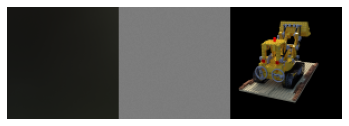

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  2  loss:  0.05824853085471697


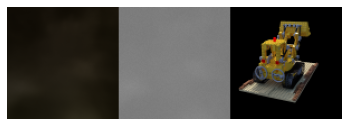

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  3  loss:  0.044047897441215164


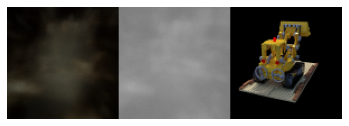

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  4  loss:  0.02739654324814232


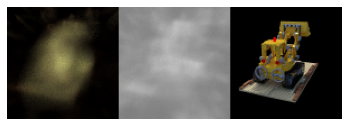

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  5  loss:  0.016511548742285147


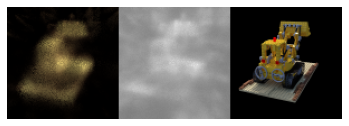

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  6  loss:  0.012912051068066999


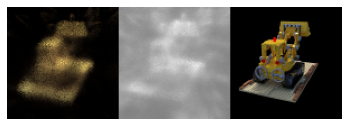

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  7  loss:  0.011427079100761343


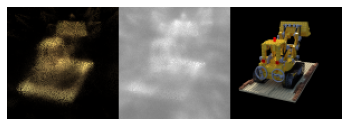

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  8  loss:  0.010524345622275725


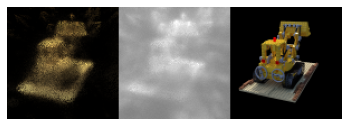

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  9  loss:  0.00982963909641273


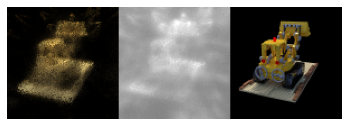

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  10  loss:  0.00905823780031973


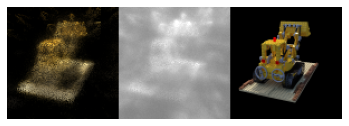

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  11  loss:  0.008269984265950867


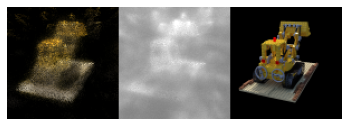

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  12  loss:  0.007792371973528938


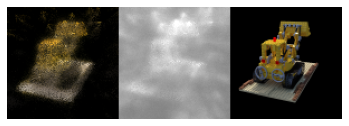

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  13  loss:  0.007450647831956234


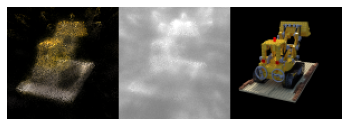

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  14  loss:  0.007187651933353463


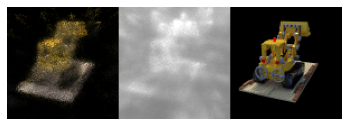

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  15  loss:  0.006956905622411076


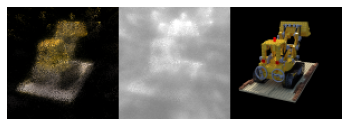

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  16  loss:  0.006764101732289131


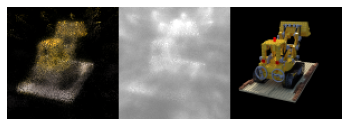

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  17  loss:  0.006601728241350725


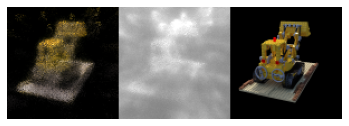

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  18  loss:  0.006424382195053869


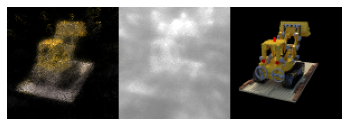

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  19  loss:  0.006276586152063767


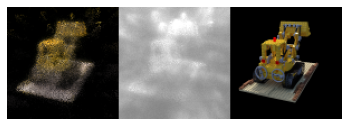

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  20  loss:  0.014920375229421353


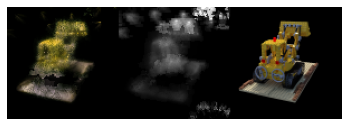

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  21  loss:  0.008144196894891173


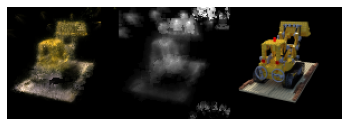

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  22  loss:  0.006747360222644073


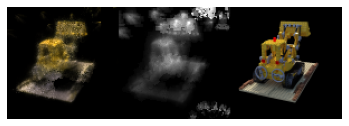

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  23  loss:  0.006013370708803292


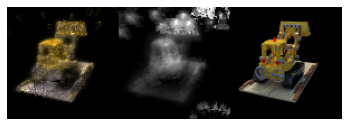

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  24  loss:  0.0055989049780234045


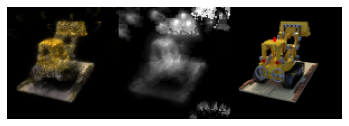

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  25  loss:  0.005205315243076359


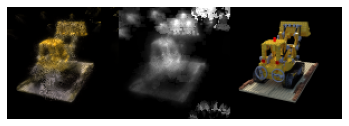

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  26  loss:  0.004898453815502664


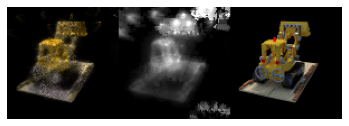

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  27  loss:  0.004629738131720561


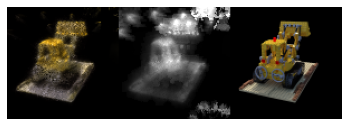

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  28  loss:  0.004417792357609254


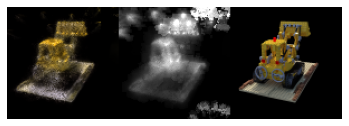

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  29  loss:  0.004259401606138033


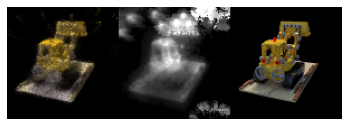

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  30  loss:  0.004086627718891232


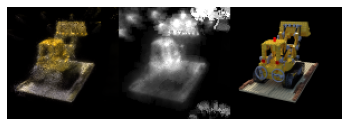

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  31  loss:  0.003958063568737633


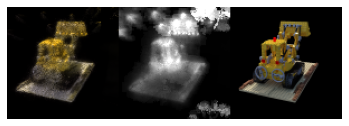

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  32  loss:  0.0038090051101512283


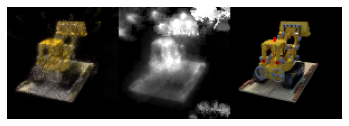

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  33  loss:  0.003662385444951523


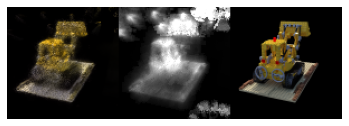

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  34  loss:  0.0035472098249452913


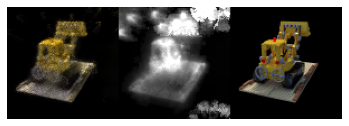

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  35  loss:  0.0034414186359315213


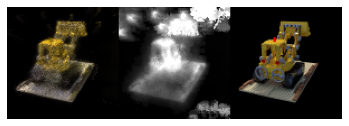

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  36  loss:  0.0033399508576072057


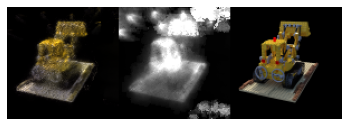

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  37  loss:  0.0032467174871750495


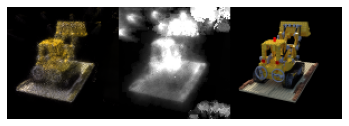

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  38  loss:  0.003156476505861933


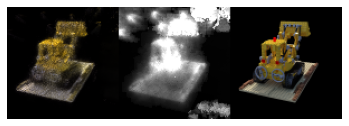

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  39  loss:  0.0030784506870894556


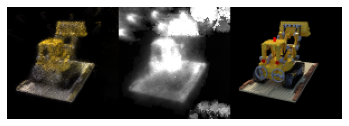

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  40  loss:  0.0029909672115380906


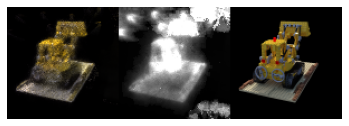

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  41  loss:  0.002910115937324104


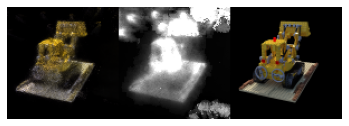

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  42  loss:  0.0028474494022804977


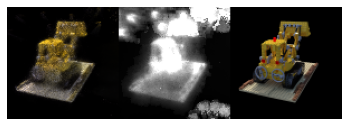

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  43  loss:  0.0027686218953815373


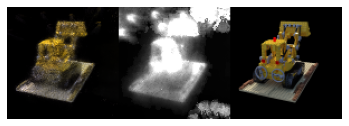

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  44  loss:  0.0027152764551034484


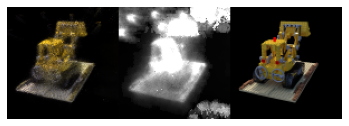

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  45  loss:  0.0026484007102227716


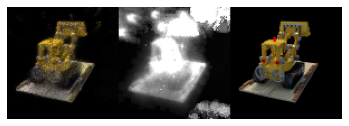

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  46  loss:  0.0025911677586576316


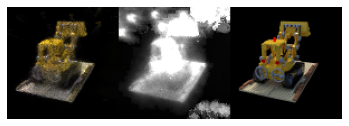

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  47  loss:  0.002531152714203772


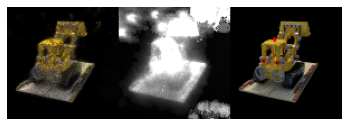

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  48  loss:  0.0024666061129005198


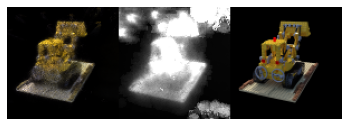

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  49  loss:  0.0024279918864759304


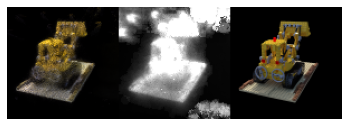

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  50  loss:  0.0023860979757985893


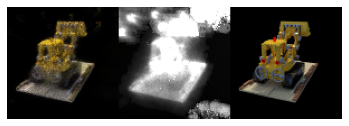

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  51  loss:  0.0023323468955634007


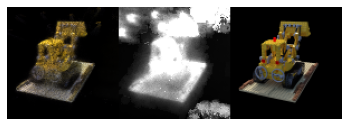

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  52  loss:  0.0022896842906215114


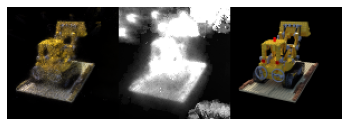

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  53  loss:  0.0022456644846103567


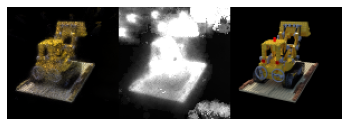

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  54  loss:  0.0022050542210408906


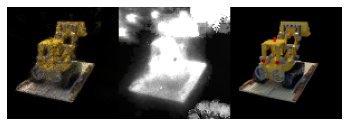

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  55  loss:  0.0021621131181331133


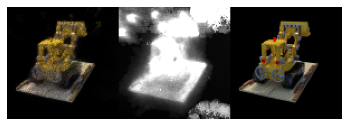

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  56  loss:  0.0021183861122151533


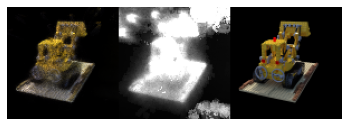

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  57  loss:  0.0020835279176697396


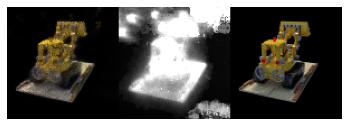

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  58  loss:  0.0020462485444325182


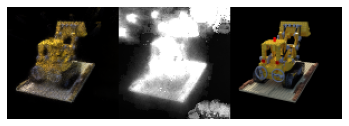

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  59  loss:  0.0020214578132427634


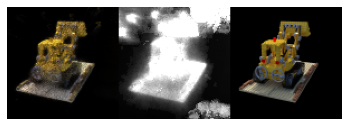

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  60  loss:  0.0019935380959657345


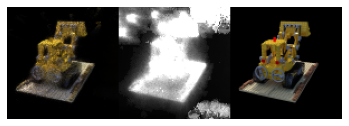

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  61  loss:  0.001965559870886237


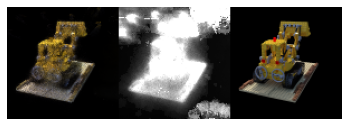

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  62  loss:  0.001934243839871374


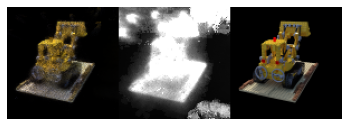

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  63  loss:  0.0019045682482111356


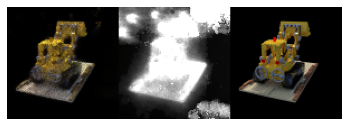

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  64  loss:  0.0018948530237690837


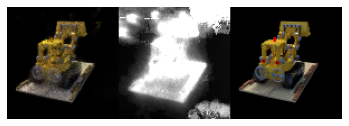

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  65  loss:  0.001853956925937151


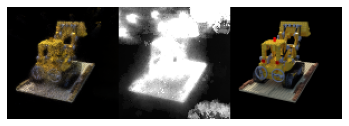

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  66  loss:  0.001833273406080125


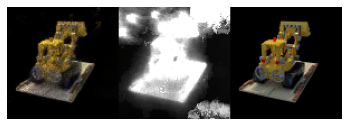

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  67  loss:  0.0018029140654809536


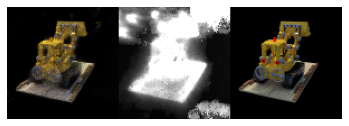

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  68  loss:  0.0017771129832439866


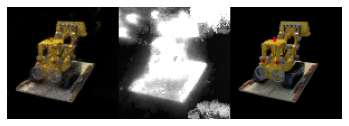

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  69  loss:  0.0017420995843222846


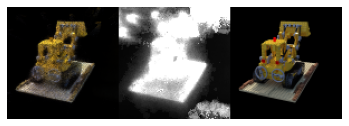

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  70  loss:  0.0017180496352429398


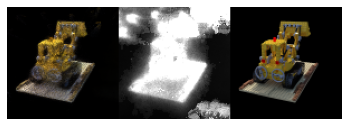

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  71  loss:  0.0017078897595512274


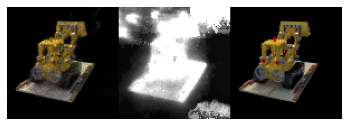

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  72  loss:  0.0016939340734530134


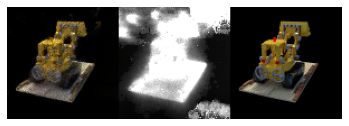

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  73  loss:  0.001674024903296979


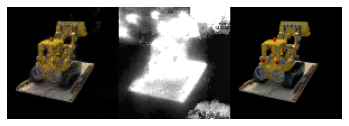

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  74  loss:  0.0016542239466051645


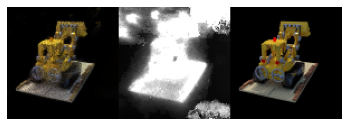

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  75  loss:  0.001629489255294154


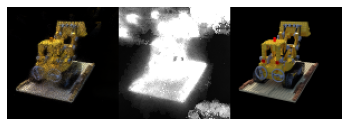

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  76  loss:  0.0016241236167718143


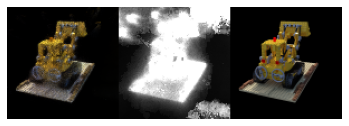

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  77  loss:  0.0016094743847846623


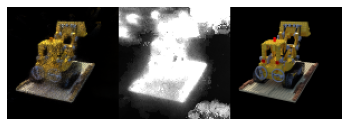

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  78  loss:  0.0015885243895319289


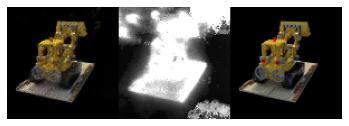

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  79  loss:  0.0015754104739140432


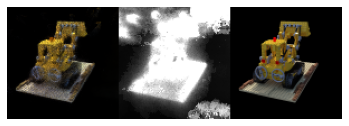

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  80  loss:  0.0015528204334088278


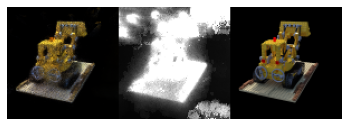

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  81  loss:  0.0015407186529163863


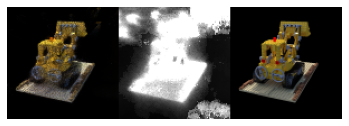

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  82  loss:  0.0015164673285726843


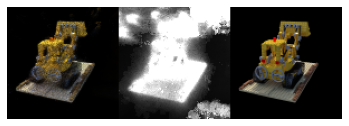

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  83  loss:  0.0015162293423158094


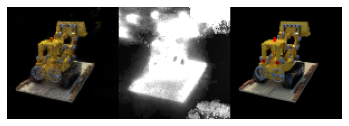

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  84  loss:  0.0014984752432805678


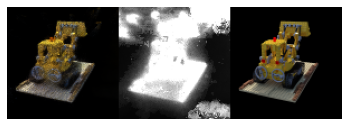

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  85  loss:  0.0014932199816985801


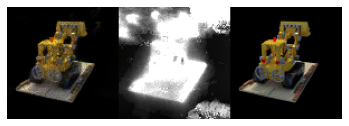

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  86  loss:  0.0014768907205662137


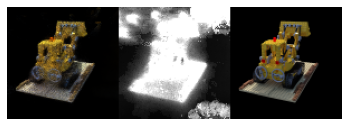

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  87  loss:  0.0014578215370791355


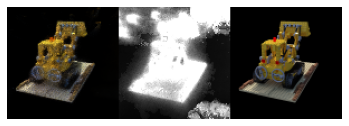

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  88  loss:  0.0014410177977354866


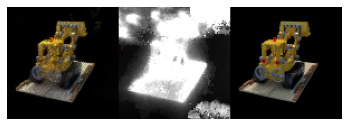

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  89  loss:  0.0014374410584557455


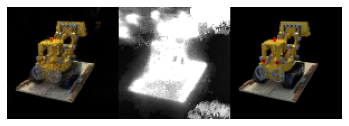

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  90  loss:  0.0014309179414238999


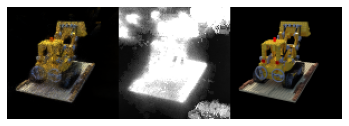

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  91  loss:  0.0014147046945160824


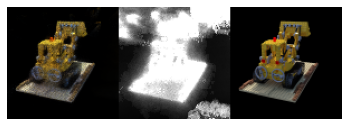

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  92  loss:  0.0014017743703260152


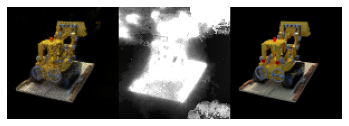

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  93  loss:  0.0013837589523552538


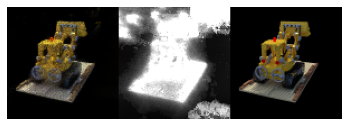

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  94  loss:  0.0013754617946239356


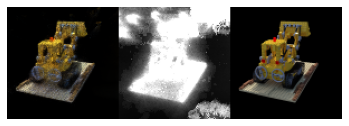

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  95  loss:  0.0013851235745609366


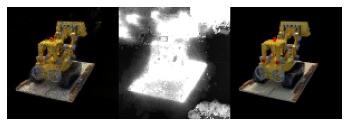

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  96  loss:  0.001357372064391412


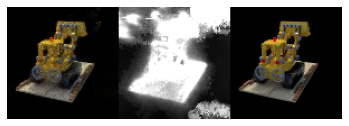

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  97  loss:  0.0013477487902758137


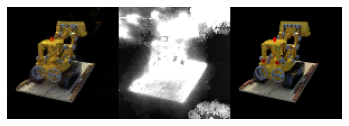

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  98  loss:  0.0013443712475265782


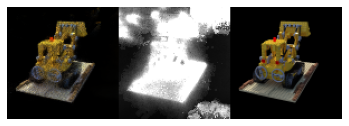

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  99  loss:  0.0013352166394028134


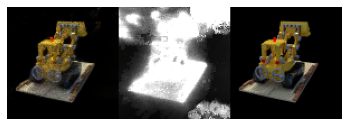

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  100  loss:  0.0013283065997994384


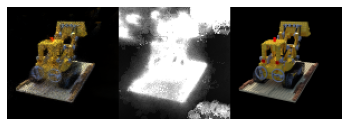

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  101  loss:  0.0013229100694692544


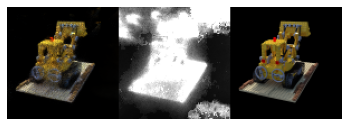

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  102  loss:  0.0013086790482642692


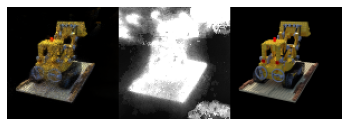

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  103  loss:  0.0012982866834851023


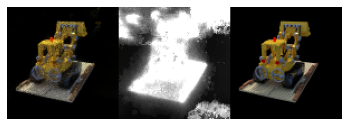

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  104  loss:  0.001283986184493625


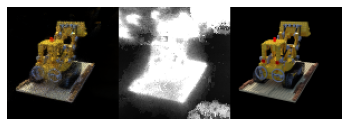

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  105  loss:  0.001294685618591779


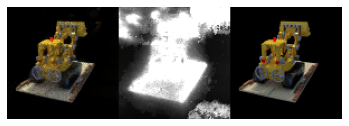

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  106  loss:  0.0012709740184880358


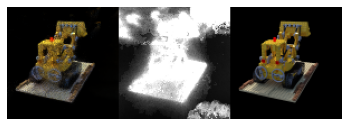

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  107  loss:  0.0012667318908705855


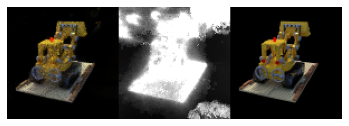

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  108  loss:  0.0012596849679685062


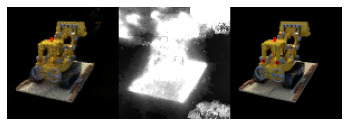

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  109  loss:  0.0012540238362608123


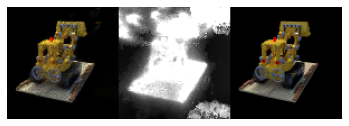

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  110  loss:  0.0012570267315994534


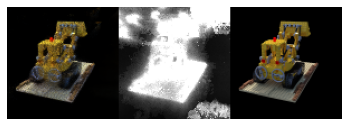

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  111  loss:  0.0012432792133735455


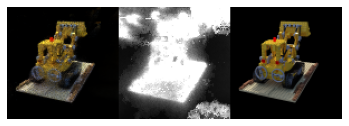

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  112  loss:  0.0012353738045798451


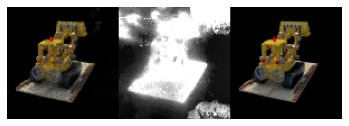

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  113  loss:  0.0012474513444645395


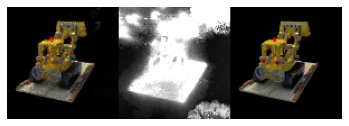

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  114  loss:  0.0012349313944933936


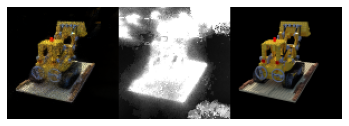

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  115  loss:  0.0012205109947118885


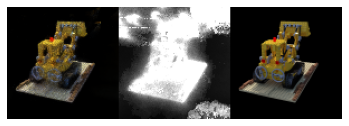

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  116  loss:  0.0012188912372474501


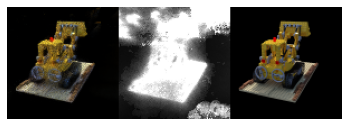

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  117  loss:  0.0012166278189841963


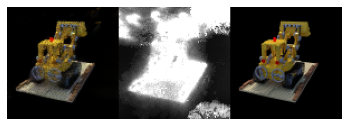

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  118  loss:  0.0012092070080581803


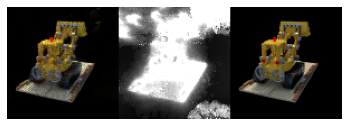

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  119  loss:  0.0012164819664535341


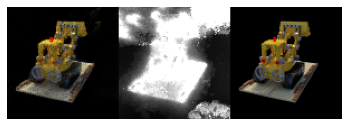

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  120  loss:  0.0012011580300765744


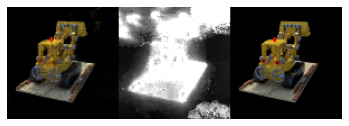

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  121  loss:  0.0012006183222421475


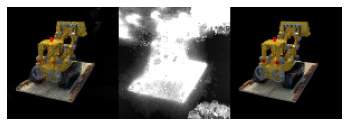

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  122  loss:  0.0011938943585351213


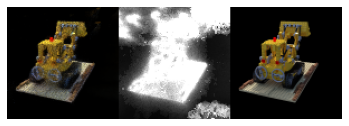

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  123  loss:  0.0011831103007010745


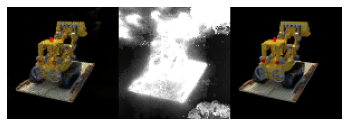

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  124  loss:  0.0011820193428886282


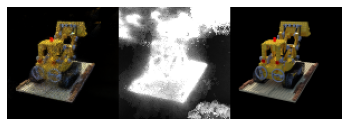

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  125  loss:  0.0011744789722031074


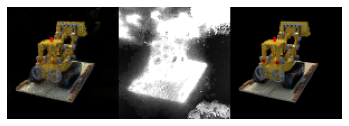

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  126  loss:  0.0011708036436118337


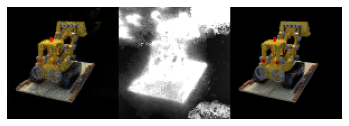

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  127  loss:  0.0011785988550695303


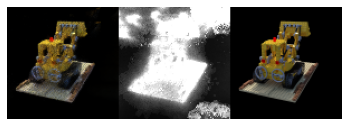

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  128  loss:  0.001168971536714396


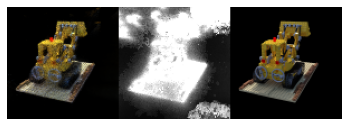

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  129  loss:  0.0011583964302023465


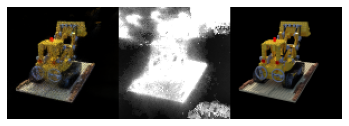

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  130  loss:  0.0011598215546254097


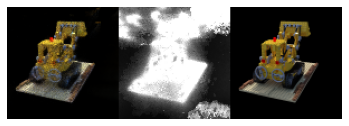

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  131  loss:  0.0011577654271519406


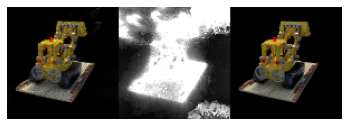

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  132  loss:  0.0011485162786409905


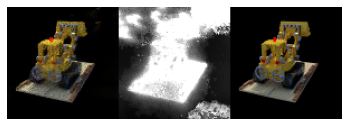

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  133  loss:  0.0011529553520820014


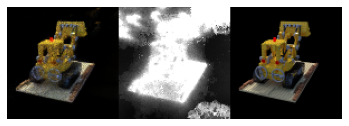

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  134  loss:  0.001162114013113733


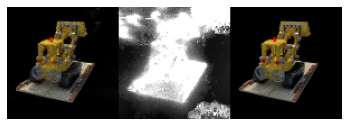

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  135  loss:  0.0011468693237033625


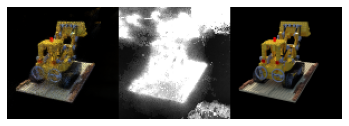

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  136  loss:  0.0011457389297361053


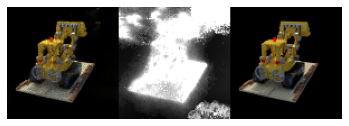

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  137  loss:  0.0011372043703803153


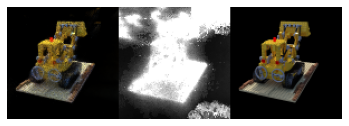

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  138  loss:  0.0011401539299897888


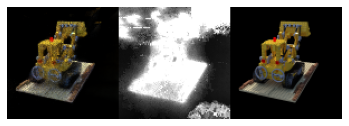

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  139  loss:  0.0011415649000924685


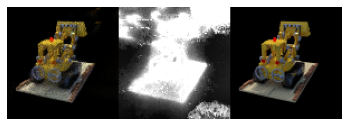

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  140  loss:  0.001135688132272649


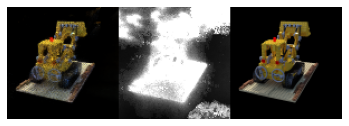

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  141  loss:  0.0011398108768204043


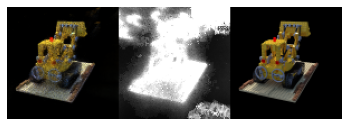

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  142  loss:  0.0011322101524885875


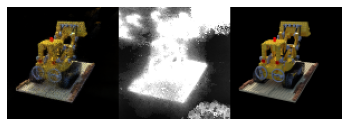

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  143  loss:  0.001124069907564793


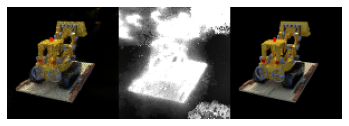

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  144  loss:  0.001123654966483702


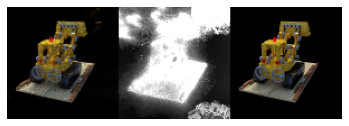

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  145  loss:  0.00112091295520532


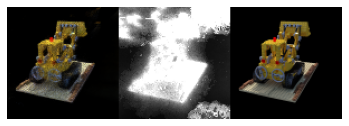

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  146  loss:  0.0011161882160579796


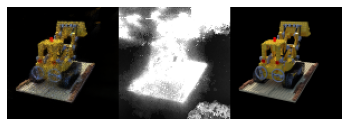

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  147  loss:  0.0011196986695609155


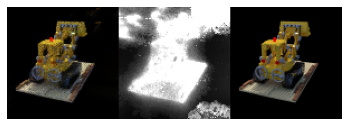

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  148  loss:  0.001124945476078981


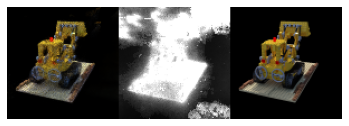

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  149  loss:  0.00113817497191233


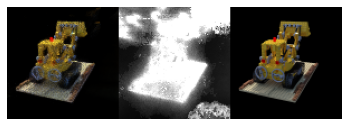

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  150  loss:  0.00112560879760491


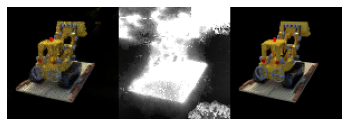

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  151  loss:  0.0011104727712240652


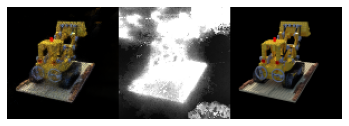

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  152  loss:  0.0011024693071381424


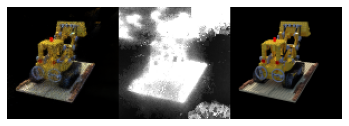

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  153  loss:  0.0010941551329684066


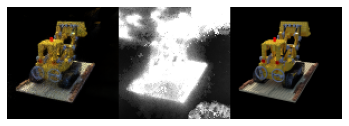

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  154  loss:  0.0010934614925461332


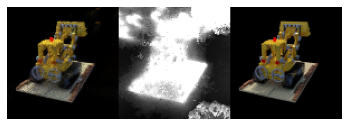

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  155  loss:  0.0010888163693745757


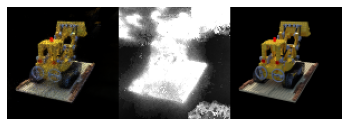

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  156  loss:  0.0010922234603064182


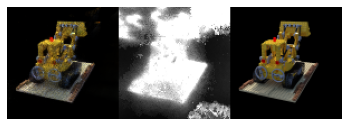

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  157  loss:  0.001099388613478893


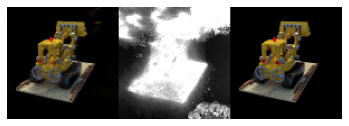

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  158  loss:  0.0010983772296038552


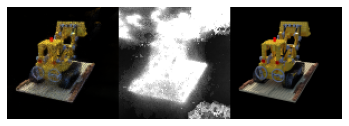

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  159  loss:  0.0010988110257540923


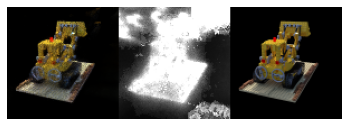

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  160  loss:  0.0010994921935885461


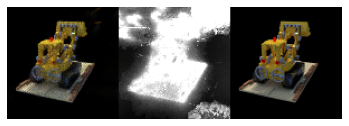

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  161  loss:  0.0010929656628825377


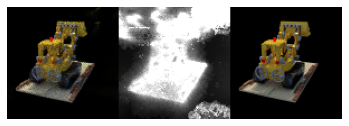

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  162  loss:  0.0010874874248708118


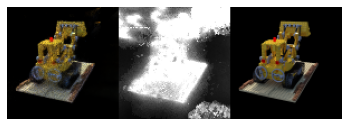

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  163  loss:  0.0010857455424162904


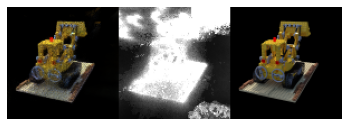

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  164  loss:  0.0010926964764502083


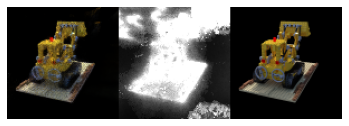

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  165  loss:  0.0010949617001522593


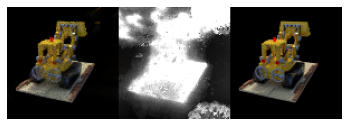

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  166  loss:  0.0010855598796970058


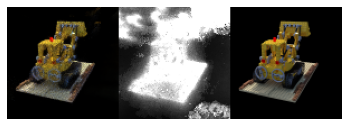

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  167  loss:  0.001083719027412813


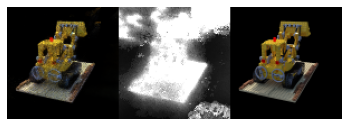

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  168  loss:  0.0010895680713872817


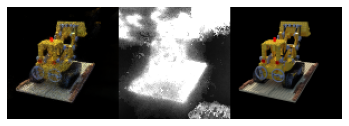

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  169  loss:  0.0010936401752836221


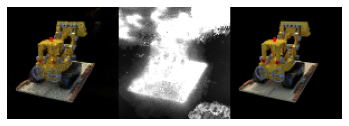

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  170  loss:  0.001086284354564794


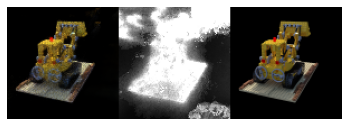

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  171  loss:  0.0010762161573891304


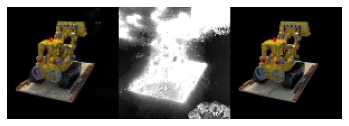

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  172  loss:  0.001071819033210902


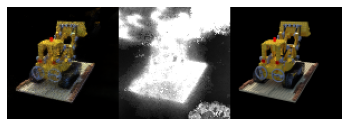

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  173  loss:  0.001083400396809732


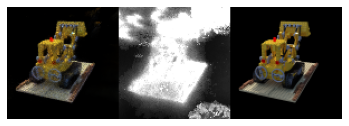

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  174  loss:  0.0010756348887866881


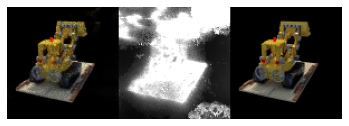

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  175  loss:  0.0010764532414006042


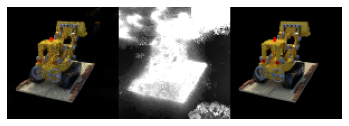

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  176  loss:  0.0010789077547533024


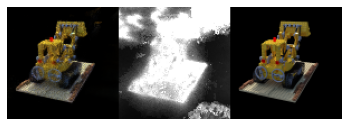

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  177  loss:  0.00106702073592569


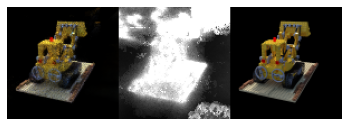

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  178  loss:  0.0010575898345752289


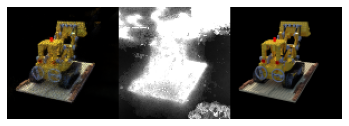

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  179  loss:  0.0010626982217192102


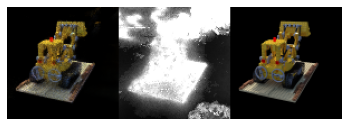

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  180  loss:  0.001052489132408009


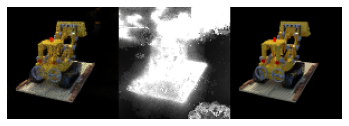

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  181  loss:  0.0010632678028661487


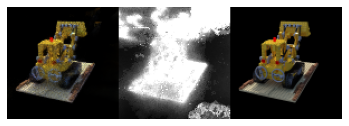

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  182  loss:  0.0010580318219030212


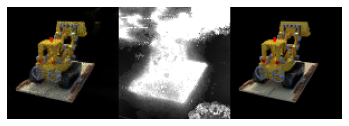

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  183  loss:  0.0010535468268391159


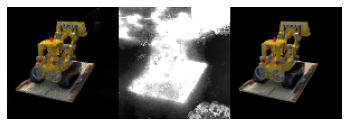

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  184  loss:  0.0010540462794779665


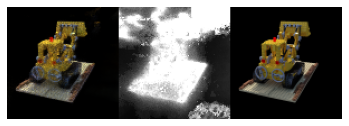

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  185  loss:  0.0010520014773436313


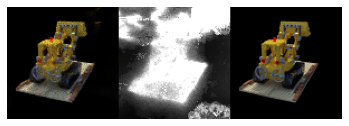

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  186  loss:  0.0010498511549894402


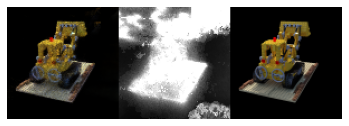

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  187  loss:  0.0010394130947813454


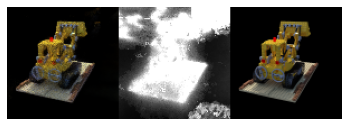

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  188  loss:  0.0010504636420282838


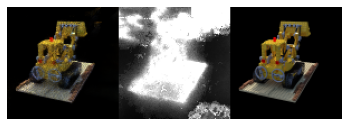

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  189  loss:  0.001055006887281084


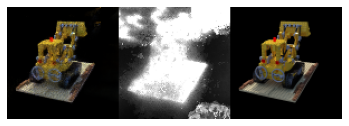

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  190  loss:  0.0010483048646159486


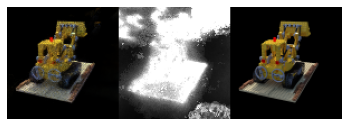

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  191  loss:  0.0010429901639941912


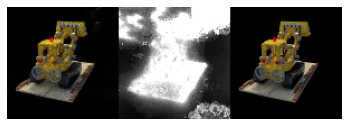

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  192  loss:  0.0010426773466324843


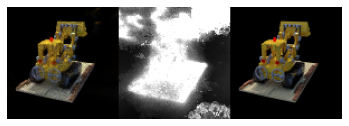

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  193  loss:  0.0010434009271088692


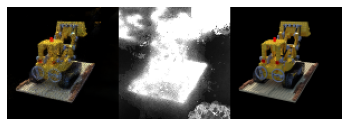

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  194  loss:  0.0010514499674941715


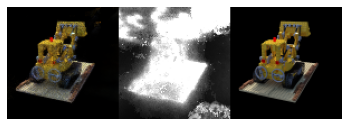

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  195  loss:  0.0010341688089254414


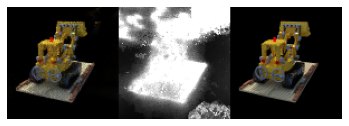

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  196  loss:  0.0010382277201945876


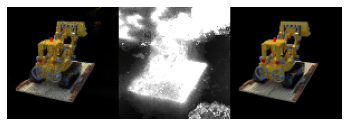

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  197  loss:  0.001031484642727577


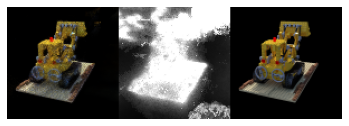

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  198  loss:  0.0010307236828883844


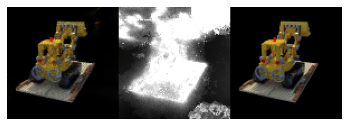

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  199  loss:  0.0010249858305556385


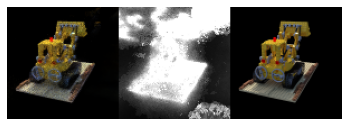

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  200  loss:  0.001025043536141739


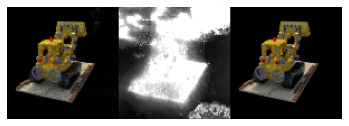

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  201  loss:  0.0010125249031891351


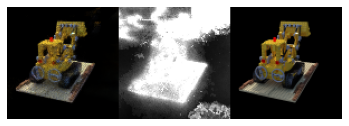

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  202  loss:  0.0010317235863099362


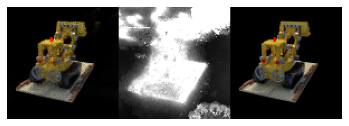

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  203  loss:  0.0010254569276779953


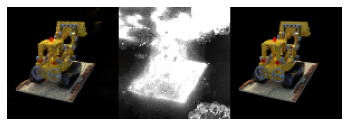

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  204  loss:  0.0010200249686590597


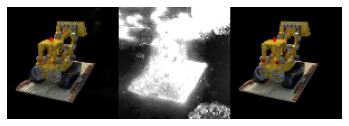

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  205  loss:  0.0010127479963825692


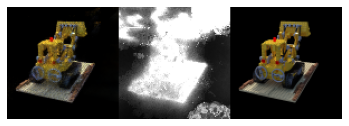

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  206  loss:  0.0010183219960138647


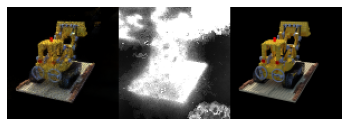

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  207  loss:  0.0010154437256536797


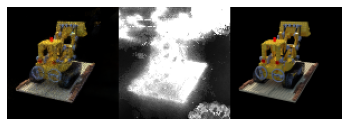

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  208  loss:  0.001002761455463698


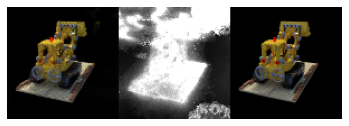

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  209  loss:  0.0009972430766347234


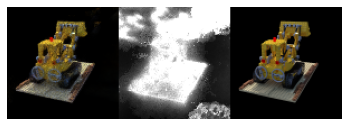

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  210  loss:  0.0009992366731182882


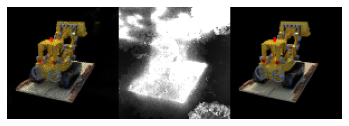

saving checkpoint


  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  211  loss:  0.001001839388123398


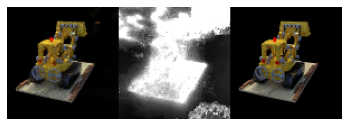

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  212  loss:  0.0010070917752397386


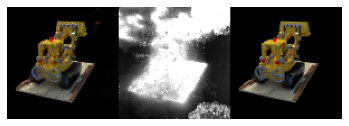

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  213  loss:  0.0010080797241973107


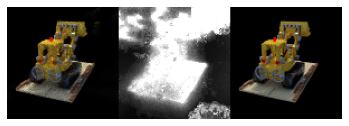

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  214  loss:  0.00099875141674929


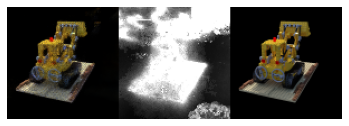

  0%|          | 0/53 [00:00<?, ?it/s]

train epoch:  215  loss:  0.0010126099042247095


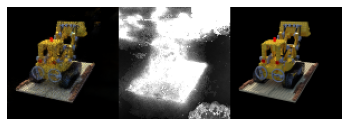

  0%|          | 0/53 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [ ]:
ckpt_dir = "/gdrive/MyDrive/Nerfies/baseNerf/"
prefix = "NerfLegoDenseFlag"


rng = jax.random.PRNGKey(0)
rng, init_rng = jax.random.split(rng)
learning_rate = 1e-3
momentum = 0.9
num_epochs = 1000
warmup_epochs = 2
occupancy_resolution = 128

batch_size = 20000 #rays/batch
steps_per_epoch = train_data["gt"].shape[0]//batch_size
state = create_train_state(init_rng, warmup_epochs,num_epochs, steps_per_epoch,learning_rate, momentum)
state = restore_checkpoint(state,ckpt_dir,prefix)
del init_rng  
#initialize grid
occupancy_grid = jnp.ones((occupancy_resolution,occupancy_resolution,occupancy_resolution))*0.01
if os.path.exists("/gdrive/MyDrive/Nerfies/baseNerf/occupancyDenseLegoFlag.npy"):
  occupancy_grid = jnp.load("/gdrive/MyDrive/Nerfies/baseNerf/occupancyDenseLegoFlag.npy")#jnp.empty((occupancy_resolution,occupancy_resolution,occupancy_resolution))


if int(state.step) >0:
  print("found existing checkpoint!!")
  print("resuming from step :",int(state.step))

for epoch in range(1, num_epochs + 1):
  # Use a separate PRNG key to permute image data during shuffling
  rng, input_rng = jax.random.split(rng)
  # Run an optimization step over a training batch
  occupancy_grid,state = train_epoch(state,occupancy_grid,train_data,test_data, batch_size, epoch, input_rng)#state, train_data,test_data, batch_size, epoch, rng
  if epoch % 10 == 0:
    print("saving checkpoint")
    save_checkpoint(state,occupancy_grid,ckpt_dir,prefix)

In [ ]:
print(train_data["poses"][1])
print(train_data["fx"])
print(train_data["fy"])
print(train_data["shiftfix"])
print(train_data["scale"])

[[-9.3054223e-01  1.1707554e-01 -3.4696460e-01 -1.3986591e+00]
 [-3.6618456e-01 -2.9751042e-01  8.8170075e-01  3.5542498e+00]
 [ 7.4505806e-09  9.4751304e-01  3.1971723e-01  1.2888215e+00]
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00  1.0000000e+00]]
138.88887889922103
138.88887889922103
[6.65347861 6.58152245 5.96621996]
13.316940943460427


In [ ]:

start_pose  = np.array([[-9.3054223e-01,  1.1707554e-01, -3.4696460e-01 ,-1.3986591e+00],
 [-3.6618456e-01, -2.9751042e-01,  8.8170075e-01  ,3.5542498e+00],
 [ 7.4505806e-09 , 9.4751304e-01 , 3.1971723e-01 , 1.2888215e+00],
 [ 0.0000000e+00 , 0.0000000e+00 , 0.0000000e+00 , 1.0000000e+00]])
shift_fix = np.array([6.65347861, 6.58152245 ,5.96621996])
scale = 13.316940943460427

def getCircle(startPose,shift_fix,scale,axis = "z",radius=0.01,angularstep = 1):
  xyz_start = (startPose[:3,-1] + shift_fix)/scale
  if axis =="x":
    Movedim =[1,2]
    fixeddim = [0]
  if axis =="y":
    Movedim =[0,2]
    fixeddim = [1]
  if axis =="z":
    Movedim =[0,1]
    fixeddim = [2]
  plane_val = xyz_start[fixeddim]
  center = xyz_start[Movedim] - radius/2**0.5
  deltas =  xyz_start[Movedim] - center
  currangle = np.arctan(deltas[0]/deltas[1])*180/np.pi
  poses = []
  for i in range(0,360,angularstep):
    angle  = currangle+i
    delta0 = np.sin(angle*np.pi/180)*radius
    delta1 = np.cos(angle*np.pi/180)*radius
    newPosinPlane = center + np.array([delta0,delta1])
    
    pos = np.array([0.0,0.0,0.0])
    for i in range(2):
      di = Movedim[i]
      pos[di] = newPosinPlane[i]
    pos[fixeddim[0]] = plane_val

    pose = np.zeros_like(startPose)
    pose[:,:] = startPose[:,:]
    pose[:3,-1] = pos

    poses.append(pose)
    del pose

  return poses
poses = getCircle(start_pose,shift_fix,scale)
for i in poses:
  print(i)
  print("-"*100)

[[-9.30542230e-01  1.17075540e-01 -3.46964600e-01  3.94596592e-01]
 [-3.66184560e-01 -2.97510420e-01  8.81700750e-01  7.61118660e-01]
 [ 7.45058060e-09  9.47513040e-01  3.19717230e-01  5.44797900e-01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
----------------------------------------------------------------------------------------------------
[[-9.30542230e-01  1.17075540e-01 -3.46964600e-01  3.94718922e-01]
 [-3.66184560e-01 -2.97510420e-01  8.81700750e-01  7.60994176e-01]
 [ 7.45058060e-09  9.47513040e-01  3.19717230e-01  5.44797900e-01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
----------------------------------------------------------------------------------------------------
[[-9.30542230e-01  1.17075540e-01 -3.46964600e-01  3.94839061e-01]
 [-3.66184560e-01 -2.97510420e-01  8.81700750e-01  7.60867576e-01]
 [ 7.45058060e-09  9.47513040e-01  3.19717230e-01  5.44797900e-01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.000000

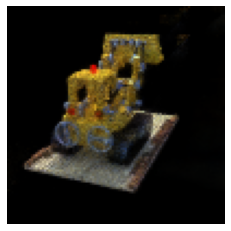

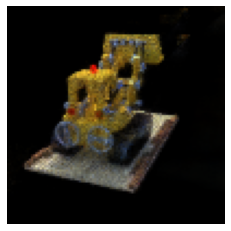

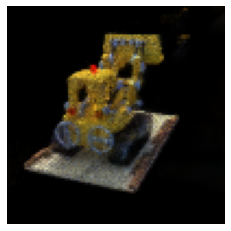

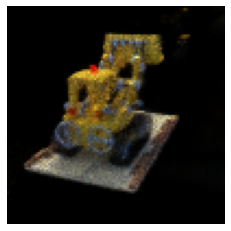

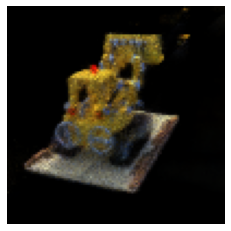

...

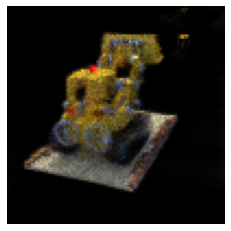

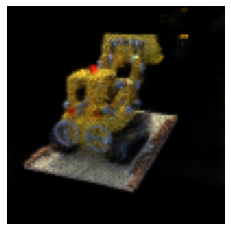

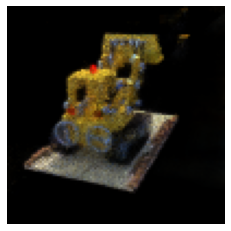

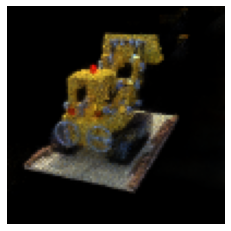

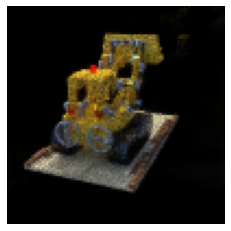

In [ ]:

def VolumeRenderSingleImage(params,occupancy_grid,gt_cols,gt_image,origins,directions,PRNGKey):
  color_op,depth_op= VolumeRenderingBatch(params,occupancy_grid,origins,directions,PRNGKey,True)
  color_op = color_op.reshape((gt_image.shape[1],gt_image.shape[0],gt_image.shape[2])).transpose(1,0,2)
  depth_op = depth_op.reshape((gt_image.shape[1],gt_image.shape[0],1)).transpose(1,0,2)
  depth_op = jnp.stack([depth_op,depth_op, depth_op], axis = 2).reshape(gt_image.shape)
  return color_op,depth_op
images = []
for i in range(len(poses)):
  focalsX,focalsY = focalsX,focalsY = 138.88887889922103,138.88887889922103
  test_camPoss_wrt_world,test_unitVecs_wrt_world,test_gt_colors,test_indexes = GetVolumeRenderData(focalsX,focalsY,jnp.asarray(poses[i]),test_data["images"],i)
  outPutImg ,oriReshape = VolumeRenderSingleImage(state.params,occupancy_grid,test_data["gt"],test_data["images"],test_camPoss_wrt_world,test_unitVecs_wrt_world,jax.random.PRNGKey(0))
  plt.imshow(np.asarray(outPutImg))
  images.append(np.asarray(outPutImg))
  plt.axis("off")
  plt.show()

In [ ]:
%matplotlib inline
from matplotlib import pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# np array with shape (frames, height, width, channels)
video = np.array(images) 

fig = plt.figure()
im = plt.imshow(video[0,:,:,:])

plt.close() # this is required to not display the generated image

def init():
    im.set_data(video[0,:,:,:])

def animate(i):
    im.set_data(video[i,:,:,:])
    return im

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=video.shape[0],
                               interval=50)
HTML(anim.to_html5_video())

In [ ]:
%matplotlib inline
from matplotlib import pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# np array with shape (frames, height, width, channels)
video = np.array(images) 

fig = plt.figure()
im = plt.imshow(video[0,:,:,:])

plt.close() # this is required to not display the generated image

def init():
    im.set_data(video[0,:,:,:])

def animate(i):
    im.set_data(video[i,:,:,:])
    return im

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=video.shape[0],
                               interval=50)
HTML(anim.to_html5_video())

In [ ]:
#create video out of list of images

width = images[0].shape[1]
hieght = images[0].shape[0]
channel = 3
fps = 30
sec = 5
# Syntax: VideoWriter_fourcc(c1, c2, c3, c4) # Concatenates 4 chars to a fourcc code
#  cv2.VideoWriter_fourcc('M','J','P','G') or cv2.VideoWriter_fourcc(*'MJPG)
fourcc = cv2.VideoWriter_fourcc(*'MP42') # FourCC is a 4-byte code used to specify the video codec.
# A video codec is software or hardware that compresses and decompresses digital video. 
# In the context of video compression, codec is a portmanteau of encoder and decoder, 
# while a device that only compresses is typically called an encoder, and one that only 
# decompresses is a decoder. Source - Wikipedia
#Syntax: cv2.VideoWriter( filename, fourcc, fps, frameSize )
video = cv2.VideoWriter('/gdrive/MyDrive/Nerfies/test.mp4', fourcc, float(fps), (width, hieght))
for frame in images:
  img = np.array(frame*255, dtype = np.uint8)
  video.write(img)

video.release()

In [ ]:


#To generate video by moving the camera inbetween cam capture points

#These code cells contain basic matrices to perform camera projection to render images.
#moving in z direction
def get_translation_matrix(tx,ty,tz):
    return np.asarray(
        [
            [1, 0, 0, tx],
            [0, 1, 0, ty],
            [0, 0, 1, tz],
            [0, 0, 0, 1],
        ]
    )
#for y axis rotation of camera
def get_rotation_matrix_phi(phi):
    return np.asarray(
        [
            [1, 0, 0, 0],
            [0, np.cos(phi), -np.sin(phi), 0],
            [0, np.sin(phi), np.cos(phi), 0],
            [0, 0, 0, 1],
        ]
    )
# for x axis rotation of camera
def get_rotation_matrix_theta(theta):
    return np.asarray(
        [
            [np.cos(theta), 0, -np.sin(theta), 0],
            [0, 1, 0, 0],
            [np.sin(theta), 0, np.cos(theta), 0],
            [0, 0, 0, 1],
        ]
    )


def pose_matrix(theta, phi, tx,ty,tz):
    camera_to_world_transform = get_translation_matrix(tx,ty,tz)
    camera_to_world_transform = get_rotation_matrix_phi(phi / 180.0 * np.pi) @ camera_to_world_transform
    camera_to_world_transform = get_rotation_matrix_theta(theta / 180.0 * np.pi) @ camera_to_world_transform
    camera_to_world_transform = np.array([
        [-1, 0, 0, 0],
        [0, 0, 1, 0],
        [0, 1, 0, 0],
        [0, 0, 0, 1]
    ]) @ camera_to_world_transform # for z axis angle
    return camera_to_world_transform
rng = jax.random.PRNGKey(0)
newRng, init_rng = jax.random.split(rng)
initialImage , initialPose , focal = trainImages[0],trainPoses[0],trainFocals[0]
outPutImg = VolumeRenderSingleImage(state.params,focal,initialPose,6.0,2.0,initialImage.shape,newRng)
print("initial position rendered")
cv2_imshow(cv2.cvtColor(np.asarray(outPutImg)*255, cv2.COLOR_BGR2RGB))
newPosX = initialPose[0,3]
newPosY = initialPose[1,3]
newPosZ = initialPose[2,3]+ 0.1 #move back
newPhi = 90
newTheta = 90
newPose = pose_matrix(newTheta, newPhi, newPosX,newPosY,newPosZ)
newOutPutImg = VolumeRenderSingleImage(state.params,focal,newPose,6.0,2.0,initialImage.shape,newRng)
